In [104]:
import numpy as pd
import matplotlib.pyplot as plt
import seaborn as sns 
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor

In [114]:
df=pd.read_csv("king country house data.csv")

## Displaying Data

In [115]:
display(df)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,"221,900.00",3,1.00,1180,5650,1.00,0,0,3,7,1180,0,1955,0,98178,47.51,-122.26,1340,5650
1,6414100192,20141209T000000,"538,000.00",3,2.25,2570,7242,2.00,0,0,3,7,2170,400,1951,1991,98125,47.72,-122.32,1690,7639
2,5631500400,20150225T000000,"180,000.00",2,1.00,770,10000,1.00,0,0,3,6,770,0,1933,0,98028,47.74,-122.23,2720,8062
3,2487200875,20141209T000000,"604,000.00",4,3.00,1960,5000,1.00,0,0,5,7,1050,910,1965,0,98136,47.52,-122.39,1360,5000
4,1954400510,20150218T000000,"510,000.00",3,2.00,1680,8080,1.00,0,0,3,8,1680,0,1987,0,98074,47.62,-122.05,1800,7503
5,7237550310,20140512T000000,"1,230,000.00",4,4.50,5420,101930,1.00,0,0,3,11,3890,1530,2001,0,98053,47.66,-122.00,4760,101930
6,1321400060,20140627T000000,"257,500.00",3,2.25,1715,6819,2.00,0,0,3,7,1715,0,1995,0,98003,47.31,-122.33,2238,6819
7,2008000270,20150115T000000,"291,850.00",3,1.50,1060,9711,1.00,0,0,3,7,1060,0,1963,0,98198,47.41,-122.31,1650,9711
8,2414600126,20150415T000000,"229,500.00",3,1.00,1780,7470,1.00,0,0,3,7,1050,730,1960,0,98146,47.51,-122.34,1780,8113
9,3793500160,20150312T000000,"323,000.00",3,2.50,1890,6560,2.00,0,0,3,7,1890,0,2003,0,98038,47.37,-122.03,2390,7570


## Checking for Data Types and null values in the DataFrame

In [116]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

The DataFrame contains 21,613 entries and 21 columns representing real estate property data for King Country. Contains numerical and categorical features, such as 'price', 'bedrooms', 'bathrooms', and more. 

No null values present.

Target variable is 'price' for prediction.

In [117]:
df.drop(['id'], axis=1, inplace=True)

## Data Statistics

In [118]:
pd.options.display.float_format = '{:,.2f}'.format
df.describe().T

,count,mean,std,min,25%,50%,75%,max
price,"21,613.00","540,182.16","367,362.23","75,000.00","321,950.00","450,000.00","645,000.00","7,700,000.00"
bedrooms,"21,613.00",3.37,0.93,0.00,3.00,3.00,4.00,33.00
bathrooms,"21,613.00",2.11,0.77,0.00,1.75,2.25,2.50,8.00
sqft_living,"21,613.00","2,079.90",918.44,290.00,"1,427.00","1,910.00","2,550.00","13,540.00"
sqft_lot,"21,613.00","15,106.97","41,420.51",520.00,"5,040.00","7,618.00","10,688.00","1,651,359.00"
floors,"21,613.00",1.49,0.54,1.00,1.00,1.50,2.00,3.50
waterfront,"21,613.00",0.01,0.09,0.00,0.00,0.00,0.00,1.00
view,"21,613.00",0.23,0.77,0.00,0.00,0.00,0.00,4.00
condition,"21,613.00",3.41,0.65,1.00,3.00,3.00,4.00,5.00
grade,"21,613.00",7.66,1.18,1.00,7.00,7.00,8.00,13.00


'price': The property prices range from $75,000 to $7,700,000, with an average of approximately $540,182 and a standard deviation of $367,362. The prices show considerable variability, indicating a diverse range of property values.

'bedrooms': The number of bedrooms per property varies from 0 to 33, with an average of approximately 3.37 bedrooms. The standard deviation of 0.93 suggests some variation in the number of bedrooms among the properties.

'bathrooms': The number of bathrooms per property ranges from 0 to 8, with an average of around 2.11 bathrooms. The standard deviation of 0.77 indicates variation in the number of bathrooms.

'sqft_living': The living area's square footage varies from 290 to 13,540 square feet, with an average of approximately 2,080 square feet. The wide range of values indicates a diverse set of property sizes.

'grade': The overall grade of the housing unit ranges from 1 to 13, with an average of approximately 7.66. Higher grades generally correspond to better-quality houses.

'yr_built': The properties were built between the years 1900 and 2015, with an average year of approximately 1971. This provides an overview of the temporal distribution of the properties.

'lat' and 'long': These features represent the latitude and longitude coordinates of the property locations. They provide spatial information about the properties' positions.

'sqft_living15': The living area's square footage of nearby houses ranges from 399 to 6,210 square feet, with an average of approximately 1,986 square feet. This feature provides insights into the surrounding living area sizes.

'sqft_lot15': The square footage of the land lots of nearby houses varies from 651 to 871,200 square feet, with an average of approximately 12,768 square feet. This gives an idea of the surrounding land sizes.


## Data Correlation

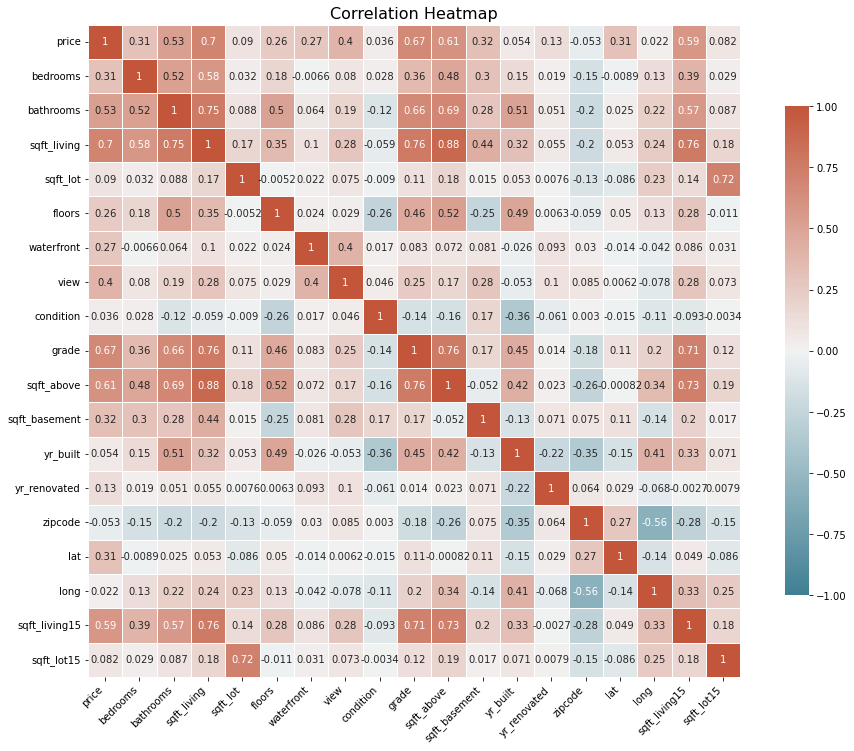

In [135]:
correlation = df.corr()
plt.figure(figsize=(16, 12))
cmap = sns.diverging_palette(220, 20, as_cmap=True)
sns.heatmap(correlation, annot=True, linewidths=0.5, vmin=-1, cmap=cmap, square=True, cbar_kws={"shrink": 0.75})
plt.xticks(rotation=45, ha='right')
plt.title("Correlation Heatmap", fontsize=16)
plt.show()

In [120]:
df.corr()['price'].sort_values().to_frame()

,price
zipcode,-0.05
long,0.02
condition,0.04
yr_built,0.05
sqft_lot15,0.08
sqft_lot,0.09
yr_renovated,0.13
floors,0.26
waterfront,0.27
lat,0.31


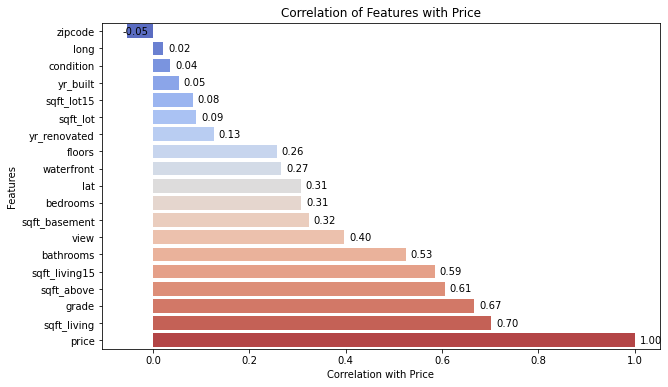

In [121]:
correlation = df.corr()['price'].sort_values()
plt.figure(figsize=(10, 6))

# Creating a horizontal bar plot with color gradients
ax = sns.barplot(x=correlation.values, y=correlation.index, palette="coolwarm")

# Adding correlation coefficient values on the plot
for i, v in enumerate(correlation.values):
    ax.text(v + 0.01 if v > 0 else v - 0.01, i, f"{v:.2f}", color='black', va='center')
plt.xlabel('Correlation with Price')
plt.ylabel('Features')
plt.title('Correlation of Features with Price')
plt.show()


Strong Positive Correlations (Values close to 1):

'sqft_living' and 'grade': Larger living area and higher overall grade are strongly positively correlated with higher 'price'.
'sqft_above' and 'sqft_living15': More square footage above ground and larger living area of nearby houses are positively correlated with higher 'price'.

Moderate Positive Correlations (Values between 0.5 and 0.7):

'bathrooms' and 'view': More bathrooms and better property views are moderately positively correlated with higher 'price'.

Weak Positive Correlations (Values between 0 and 0.5):

'bedrooms', 'waterfront', 'lat', 'yr_renovated', 'sqft_basement', 'floors', 'yr_built', 'condition', 'sqft_lot', 'sqft_lot15': These features have weak positive correlations with 'price', suggesting a mild impact on property prices.

Weak Negative Correlation (Value close to -0.05):

'zipcode': The 'price' has a weak negative correlation with 'zipcode', indicating some variation in property prices across different zip codes.
Overall, 'sqft_living', 'grade', 'sqft_above', 'bathrooms', and 'view' are the most important features positively influencing property prices.
keeping in mind that correlation does not imply causation, and other factors may also contribute to property price variations.

## Regression Analysis

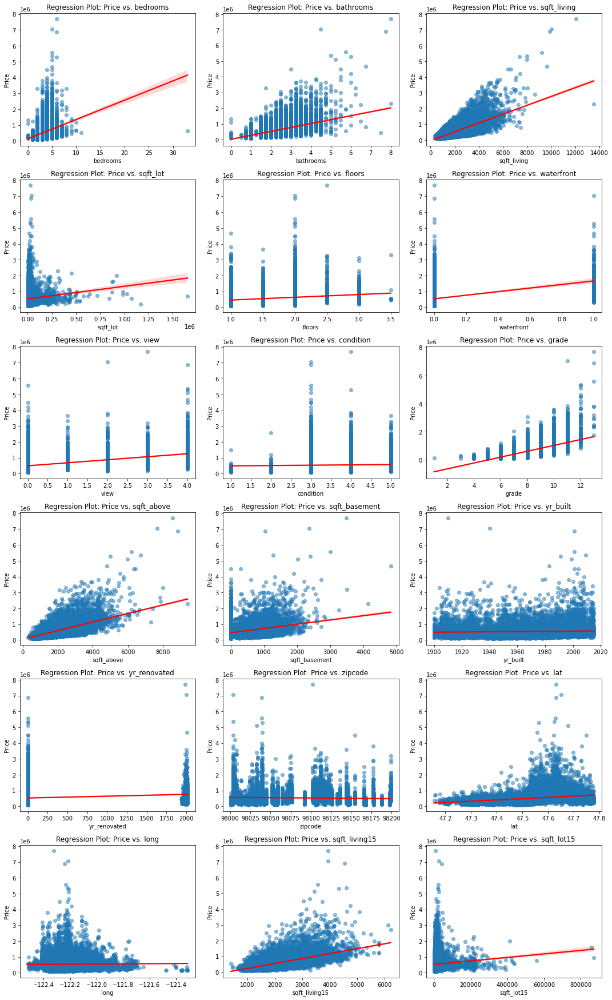

In [122]:
# Set the columns for regression plots (excluding 'price' and 'date')
columns_for_regression = df.columns.drop(['price', 'date'])

# Set the number of rows and columns for subplots
num_rows = len(columns_for_regression) // 3 + 1
num_cols = min(3, len(columns_for_regression))

# Set the size of the plot
plt.figure(figsize=(5*num_cols, 4*num_rows))

# Loop through each column and create a regression plot against 'price'
for i, column in enumerate(columns_for_regression):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.regplot(x=column, y='price', data=df, scatter_kws={'alpha': 0.5}, line_kws={'color': 'red'})
    plt.xlabel(column)
    plt.ylabel('Price')
    plt.title(f'Regression Plot: Price vs. {column}')

plt.tight_layout()

plt.show()


## Ploting Data Counts

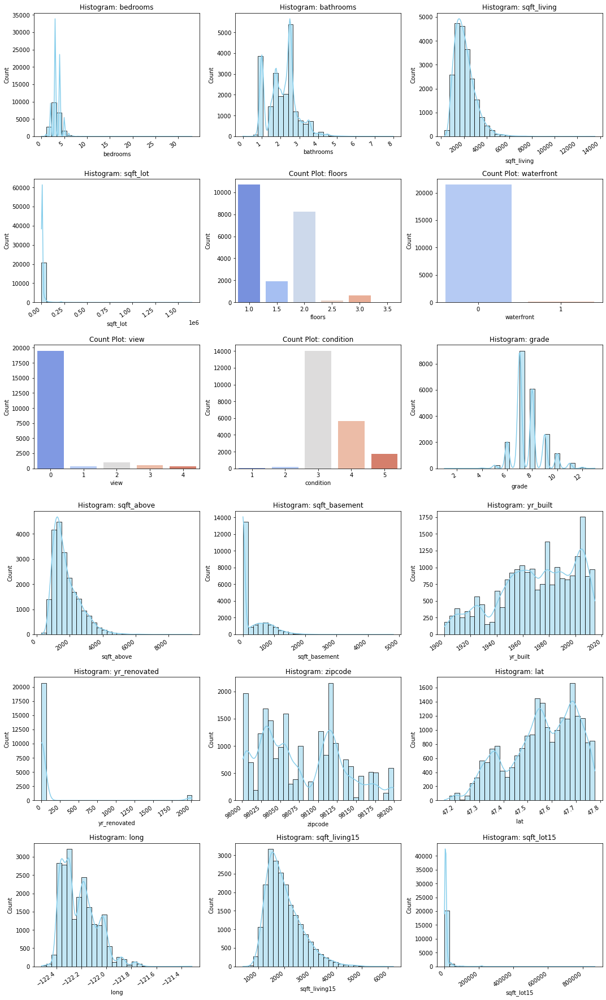

In [123]:
# Set the columns for count plots (excluding 'price' and 'date')
columns_for_count = df.columns.drop(['price', 'date'])

num_rows = len(columns_for_count) // 3 + 1
num_cols = min(3, len(columns_for_count))

plt.figure(figsize=(5*num_cols, 4*num_rows))

# Looping through each column and create a count plot
for i, column in enumerate(columns_for_count):
    plt.subplot(num_rows, num_cols, i + 1)
    
    # Checking if the column is categorical (object or integer with few unique values)
    if df[column].dtype == 'object' or df[column].nunique() < 10:
        sns.countplot(x=column, data=df, palette='coolwarm')
        plt.xlabel(column)
        plt.ylabel('Count')
        plt.title(f'Count Plot: {column}')
         
    else:
        sns.histplot(df[column], kde=True, color='skyblue', bins=30)
        plt.xlabel(column)
        plt.ylabel('Count')
        plt.title(f'Histogram: {column}')
        plt.xticks(rotation=35, ha='right')

plt.tight_layout()

plt.show()

## Building a Regression Model

In [124]:
X = df.drop(['price', 'date'], axis=1)
y = df['price']

# Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [125]:
model = LinearRegression()

In [126]:
model.fit(X_train, y_train)

LinearRegression()

In [127]:
y_pred = model.predict(X_test)

In [128]:
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse:.2f}")
print(f"R-squared: {r2:.2f}")

Mean Squared Error: 45224874244.73
R-squared: 0.70


An R2 score of 0.70 suggests that the model is capturing some of the patterns and relationships in the data, but there might be other factors contributing to the price that the model is not capturing effectively.

## Feature Importance Analysis (Using Random Forest)

In [132]:
X = df.drop(['price', 'date'], axis=1)
y = df['price']

model = RandomForestRegressor(random_state=42)
model.fit(X, y)

feature_importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)

print(feature_importances)



grade           0.31
sqft_living     0.28
lat             0.16
long            0.07
sqft_living15   0.03
waterfront      0.03
yr_built        0.03
sqft_above      0.02
sqft_lot        0.01
zipcode         0.01
sqft_lot15      0.01
view            0.01
bathrooms       0.01
sqft_basement   0.01
bedrooms        0.00
condition       0.00
floors          0.00
yr_renovated    0.00
dtype: float64


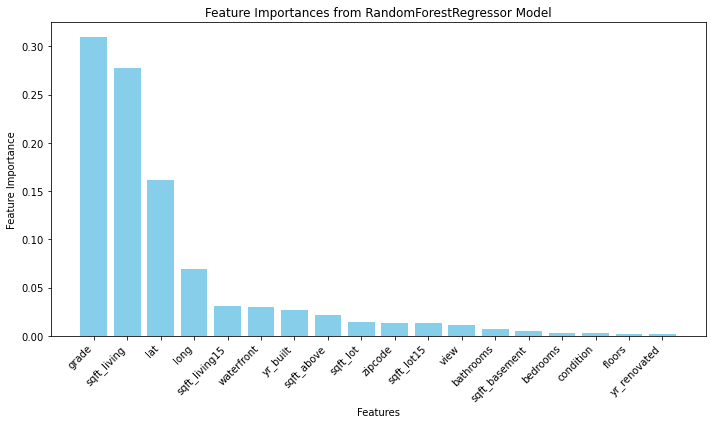

In [134]:
plt.figure(figsize=(10, 6))
plt.bar(feature_importances.index, feature_importances.values, color='skyblue')
plt.xlabel('Features')
plt.ylabel('Feature Importance')
plt.title('Feature Importances from RandomForestRegressor Model')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

The feature importance scores indicate the relative importance of each feature in predicting the target variable ('price'). Higher values indicate greater importance, and lower values indicate lesser importance.

The top five most important features for predicting the 'price' are:

grade: The overall grade given to the housing unit.
sqft_living: The living area's square footage.
lat: Latitude coordinate of the location.
long: Longitude coordinate of the location.
sqft_living15: The living area's square footage of nearby houses.

These results suggest that the overall grade, living area size, and location (latitude and longitude) play significant roles in determining property prices.